In [5]:
%run 00_config_and_utils.ipynb

import cvxpy as cvx
from sklearn.covariance import LedoitWolf
import statsmodels.api as sm

In [6]:
ret = pd.read_parquet("../data/processed/ret.parquet")
spy_ret = pd.read_parquet("../data/processed/spy_ret.parquet")["SPY"]
beta = pd.read_parquet("../data/processed/beta.parquet")
signals_p = pd.read_parquet("../data/processed/signals_purified.parquet")

ret.shape, signals_p.shape

((2512, 50), (2512, 150))

In [14]:
def ledoit_wolf_cov(returns_window: pd.DataFrame):
    X = returns_window.fillna(0.0).values
    return LedoitWolf().fit(X).covariance_

def solve_portfolio(alpha: pd.Series,
                    sigma: np.ndarray,
                    w_prev: pd.Series,
                    lam_risk: float,
                    gamma_turnover: float,
                    gross_leverage: float,
                    pos_cap: float,
                    beta_vec: pd.Series | None = None):
    tickers = alpha.index
    n = len(tickers)

    w = cvx.Variable(n)
    Sigma = cvx.Parameter((n, n), PSD=True, value=sigma)

    obj = cvx.Minimize(
        -alpha.values @ w
        + lam_risk * cvx.quad_form(w, Sigma)
        + gamma_turnover * cvx.norm1(w - w_prev.values)
    )

    constraints = [
        cvx.sum(w) == 0,
        cvx.norm1(w) <= gross_leverage,
        w <= pos_cap,
        w >= -pos_cap,
    ]

    if beta_vec is not None:
        constraints.append(beta_vec.values @ w == 0)

    prob = cvx.Problem(obj, constraints)
    prob.solve(solver=cvx.OSQP)

    if w.value is None:
        return None

    return pd.Series(w.value, index=tickers)

def run_backtest(rebalance_rule: str,
                 lam_risk: float,
                 gamma_turnover: float,
                 tcost_bps: float,
                 lookback_cov: int = 252,
                 use_beta_neutral: bool = True,
                 min_names: int = 20):

    reb_dates = make_rebalance_dates(ret.index, rebalance_rule)

    portfolio_rets = []
    turnover_rows = []
    weights_hist = {}

    w_prev_full = pd.Series(0.0, index=ret.columns)
    tcost = tcost_bps / 1e4

    for i in range(len(reb_dates) - 1):
        t = reb_dates[i]
        t_next = reb_dates[i + 1]

        if t not in signals_p.index or t not in beta.index:
            continue

        mom_t = signals_p.loc[t, ("mom", slice(None))].droplevel(0)
        rev_t = signals_p.loc[t, ("rev", slice(None))].droplevel(0)
        lowv_t = signals_p.loc[t, ("lowvol", slice(None))].droplevel(0)

        alpha = (mom_t + rev_t + lowv_t) / 3.0
        alpha = alpha.dropna()

        if len(alpha) < min_names:
            continue

        beta_vec = beta.loc[t, alpha.index].dropna()
        alpha = alpha.loc[beta_vec.index]

        if len(alpha) < min_names:
            continue

        ret_win = ret.loc[:t].tail(lookback_cov)[alpha.index]

        if ret_win.shape[0] < lookback_cov * 0.8:
            continue

        sigma = ledoit_wolf_cov(ret_win)

        w_prev = w_prev_full.reindex(alpha.index).fillna(0.0)

        beta_constraint = beta_vec if use_beta_neutral else None

        w_new = solve_portfolio(
            alpha=alpha,
            sigma=sigma,
            w_prev=w_prev,
            lam_risk=lam_risk,
            gamma_turnover=gamma_turnover,
            gross_leverage=CONFIG["gross_leverage"],
            pos_cap=CONFIG["pos_cap"],
            beta_vec=beta_constraint
        )

        if w_new is None:
            continue

        turnover = (w_new - w_prev).abs().sum()
        cost = tcost * turnover

        period_rets = ret.loc[t:t_next, alpha.index].iloc[1:]
        daily_port = period_rets @ w_new

        if len(daily_port) > 0:
            daily_port.iloc[0] -= cost

        portfolio_rets.append(daily_port)
        turnover_rows.append({"date": t, "turnover": turnover})
        weights_hist[t] = w_new

        w_prev_full.loc[w_new.index] = w_new

    if len(portfolio_rets) == 0:
        return None

    port_ret = pd.concat(portfolio_rets).sort_index()
    turnover_df = pd.DataFrame(turnover_rows).set_index("date").sort_index()

    equity = (1 + port_ret.fillna(0.0)).cumprod()
    mdd, _ = max_drawdown(equity)
    stats = annualized_stats(port_ret)

    common = port_ret.index.intersection(spy_ret.index)
    y = port_ret.loc[common]
    x = spy_ret.loc[common]
    X = sm.add_constant(x)
    reg = sm.OLS(y, X, missing="drop").fit()

    out = {
        "n_days": int(port_ret.shape[0]),
        "ann_return": float(stats["ann_return"]),
        "ann_vol": float(stats["ann_vol"]),
        "sharpe": float(stats["sharpe"]),
        "max_drawdown": float(mdd),
        "avg_turnover": float(turnover_df["turnover"].mean()) if len(turnover_df) else np.nan,
        "reg_alpha_daily": float(reg.params["const"]),
        "reg_beta": float(reg.params.iloc[1]),
        "reg_r2": float(reg.rsquared),
    }
    return out

In [15]:
# define robustness grid

grid = []

lam_list = [0.5, 1, 2, 5, 10]
gamma_list = [0, 0.5, 1, 2, 5]
cost_list = [1, 5, 10, 20]
rebalance_list = ["W-FRI", "M"]

for reb in rebalance_list:
    for lam in lam_list:
        for gamma in gamma_list:
            for cost in cost_list:
                grid.append((reb, lam, gamma, cost))

len(grid)

200

In [16]:
# run the grid and store result
rows = []

for reb, lam, gamma, cost in grid:
    res = run_backtest(
        rebalance_rule=reb,
        lam_risk=lam,
        gamma_turnover=gamma,
        tcost_bps=cost,
        lookback_cov=CONFIG["lookback_cov"],
        use_beta_neutral=True
    )
    if res is None:
        continue
    res.update({"rebalance": reb, "lam_risk": lam, "gamma_turnover": gamma, "tcost_bps": cost})
    rows.append(res)

results = pd.DataFrame(rows)
results.shape

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future ve

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future ve

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adj

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future ve

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/problems/problem.py:1539: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future ve

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future ve

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/var/folders/yz/7szystj11p33mq6mw_djrn8h0000gn/T/ipykernel_28627/2598054570.py:29: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = s.resample(rule).last().index
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized problem that is not DPP. Because the problem is not DPP, subsequent solves will not be faster than the first one. For more information, see the documentation on Disciplined Parametrized Programming, at https://www.cvxpy.org/tutorial/dpp/index.html
  warnings.warn(DPP_ERROR_MSG)
/Users/wangzhenghua/jenv/lib/python3.10/site-packages/cvxpy/reductions/solvers/solving_chain.py:242: UserWarning: You are solving a parameterized prob

(200, 13)

In [24]:
results.columns.tolist(), results.head()

(['n_days',
  'ann_return',
  'ann_vol',
  'sharpe',
  'max_drawdown',
  'avg_turnover',
  'reg_alpha_daily',
  'reg_beta',
  'reg_r2',
  'rebalance',
  'lam_risk',
  'gamma_turnover',
  'tcost_bps'],
    n_days  ann_return   ann_vol    sharpe  max_drawdown  avg_turnover  \
 0    2255    0.005590  0.045048  0.124085     -0.078217      0.625813   
 1    2255   -0.007110  0.045155 -0.157470     -0.100317      0.625813   
 2    2255   -0.022986  0.045373 -0.506599     -0.201221      0.625813   
 3    2255   -0.054737  0.046090 -1.187600     -0.397909      0.625813   
 4    2255    0.018189  0.041628  0.436931     -0.067657      0.108285   
 
    reg_alpha_daily  reg_beta    reg_r2 rebalance  lam_risk  gamma_turnover  \
 0         0.000012  0.015758  0.004190     W-FRI       0.5             0.0   
 1        -0.000038  0.015884  0.004237     W-FRI       0.5             0.0   
 2        -0.000101  0.016043  0.004281     W-FRI       0.5             0.0   
 3        -0.000227  0.016360  0.0043

In [25]:
# shows that the best sharpe is 0.67 with lam_risk around 10 and drawndo0wnaround 8.5% adn turnover 0.02
# model is fairly risk adverse, moderate turnover penalty and low trading

results.sort_values(["sharpe", "max_drawdown"], ascending=[False, True]).head(15)

,n_days,ann_return,ann_vol,sharpe,max_drawdown,avg_turnover,reg_alpha_daily,reg_beta,reg_r2,rebalance,lam_risk,gamma_turnover,tcost_bps
88,2255,0.024662,0.036783,0.670459,-0.085558,0.020583,0.000103,-0.008927,0.002017,W-FRI,10.0,1.0,1
28,2255,0.024526,0.036817,0.666179,-0.085888,0.020572,0.000103,-0.009327,0.002198,W-FRI,1.0,1.0,1
68,2255,0.024531,0.036886,0.665048,-0.084445,0.020516,0.000103,-0.008926,0.002005,W-FRI,5.0,1.0,1
89,2255,0.024244,0.036788,0.659023,-0.085977,0.020583,0.000102,-0.008913,0.002010,W-FRI,10.0,1.0,5
29,2255,0.024109,0.036821,0.654760,-0.086306,0.020572,0.000101,-0.009313,0.002190,W-FRI,1.0,1.0,5
69,2255,0.024114,0.036890,0.653683,-0.084866,0.020516,0.000101,-0.008912,0.001998,W-FRI,5.0,1.0,5
48,2255,0.024023,0.036801,0.652797,-0.086068,0.020577,0.000101,-0.008816,0.001965,W-FRI,2.0,1.0,1
8,2255,0.024088,0.036921,0.652442,-0.086257,0.020515,0.000101,-0.008677,0.001891,W-FRI,0.5,1.0,1
90,2255,0.023722,0.036794,0.644725,-0.086501,0.020583,0.000100,-0.008895,0.002001,W-FRI,10.0,1.0,10
49,2255,0.023606,0.036805,0.641368,-0.086491,0.020577,0.000099,-0.008802,0.001958,W-FRI,2.0,1.0,5


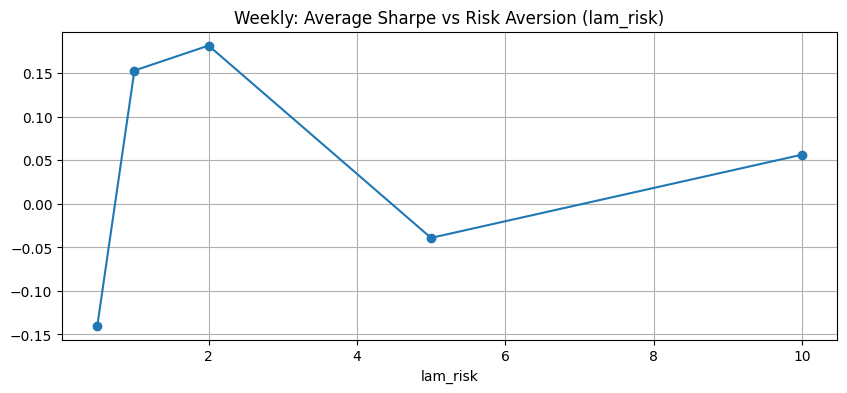

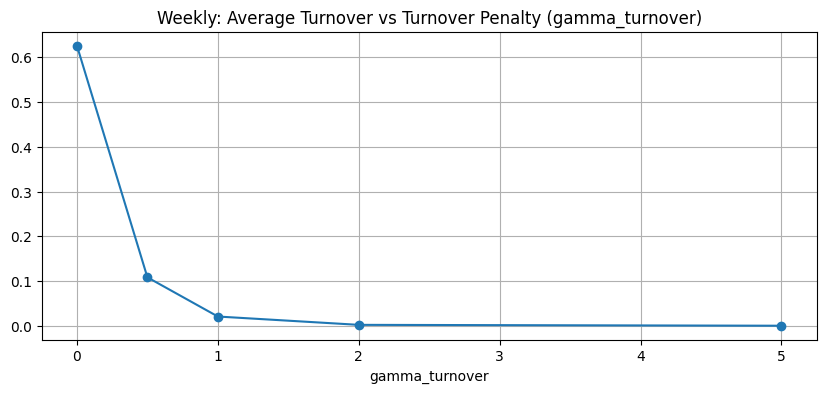

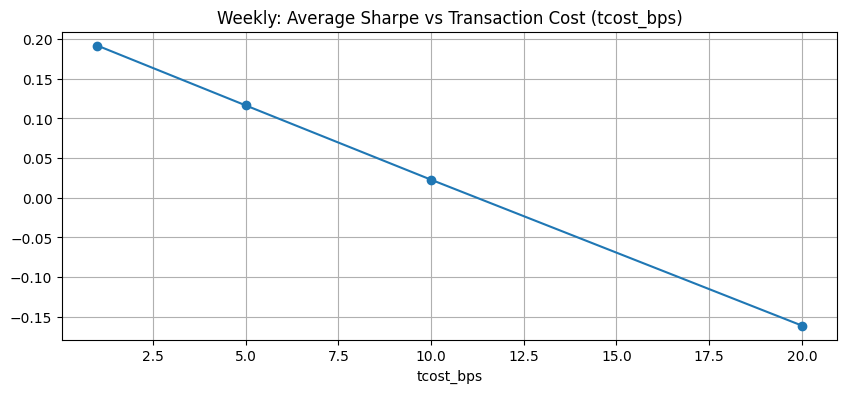

In [26]:
# show if sharpe is stable as i very lanmda, y and costs
# if sharpe collapses for slightly hugher cost, strat may be too high turnover
import matplotlib.pyplot as plt

weekly = results[results["rebalance"] == "W-FRI"].copy()
monthly = results[results["rebalance"] == "M"].copy()

plt.figure(figsize=(10,4))
weekly.groupby("lam_risk")["sharpe"].mean().plot(marker="o")
plt.grid(True)
plt.title("Weekly: Average Sharpe vs Risk Aversion (lam_risk)")
plt.show()

plt.figure(figsize=(10,4))
weekly.groupby("gamma_turnover")["avg_turnover"].mean().plot(marker="o")
plt.grid(True)
plt.title("Weekly: Average Turnover vs Turnover Penalty (gamma_turnover)")
plt.show()

plt.figure(figsize=(10,4))
weekly.groupby("tcost_bps")["sharpe"].mean().plot(marker="o")
plt.grid(True)
plt.title("Weekly: Average Sharpe vs Transaction Cost (tcost_bps)")
plt.show()

In [ ]:
# 1) tells us how sensitive the performance is to risk aversion
# too low lam_risk lets the portfolio takes on too much risk/ noisy weights while too high lam_risk dilutes alpha
# 2) as gamma_turnover increases, turnover decreases to zero.
# 3) sharpe drops as cost increase
# important to show edge while varying trading cost

In [20]:
# create a grid view of sharpe across (lambda, y)
pivot = weekly.pivot_table(
    index="lam_risk",
    columns="gamma_turnover",
    values="sharpe",
    aggfunc="mean"
)
pivot

gamma_turnover,0.0,0.5,1.0,2.0,5.0
lam_risk,,,,,
0.5,-0.431896,0.331225,0.629725,-0.025343,-1.203183
1.0,-0.423429,0.322912,0.643337,-0.029263,0.251237
2.0,-0.423846,0.326548,0.629935,-0.048380,0.423834
5.0,-0.424673,0.327298,0.642314,-0.033361,-0.707591
10.0,-0.421925,0.327225,0.647582,-0.066814,-0.204569


In [27]:
os.makedirs("outputs/results", exist_ok=True)

results.to_parquet("outputs/results/robustness_results.parquet")
results.to_csv("outputs/results/robustness_results.csv", index=False)

results.describe()

,n_days,ann_return,ann_vol,sharpe,max_drawdown,avg_turnover,reg_alpha_daily,reg_beta,reg_r2,lam_risk,gamma_turnover,tcost_bps
count,200.000000,2.000000e+02,2.000000e+02,200.000000,200.000000,2.000000e+02,2.000000e+02,2.000000e+02,2.000000e+02,200.000000,200.0000,200.000000
mean,2228.000000,4.753376e-03,2.503869e-02,0.056542,-0.069165,1.830374e-01,1.876593e-05,1.661076e-04,1.166613e-03,3.700000,1.7000,9.000000
std,27.067754,1.429753e-02,1.825205e-02,0.478233,0.070203,2.826712e-01,5.966603e-05,6.646096e-03,1.371338e-03,3.524501,1.7821,7.124168
min,2201.000000,-5.473669e-02,2.105943e-22,-1.290159,-0.397909,8.533574e-22,-2.274343e-04,-9.326744e-03,2.882843e-07,0.500000,0.0000,1.000000
25%,2201.000000,-4.974575e-06,8.341179e-06,-0.164311,-0.089717,8.356174e-06,-2.056914e-08,-1.655180e-03,1.180630e-04,1.000000,0.5000,4.000000
50%,2228.000000,1.982064e-22,3.326169e-02,0.115743,-0.068314,3.128878e-02,7.238354e-25,1.975293e-23,6.286618e-04,2.000000,1.0000,7.500000
75%,2255.000000,1.396360e-02,4.164645e-02,0.432692,-0.000062,2.060558e-01,5.535328e-05,1.719333e-04,1.822859e-03,5.000000,2.0000,12.500000
max,2255.000000,2.466184e-02,4.609016e-02,0.670459,0.000000,8.261007e-01,1.034438e-04,1.636024e-02,4.762394e-03,10.000000,5.0000,20.000000
